## Digital Marketing Strategy

In this Python file we investigate which factors drive consumers engagement with brand post popularity with U.S. theme parc posts on Facebook

In [2]:
# Import libraries
import numpy as np
import pandas as pd
import os
import re
import emoji

In [3]:
# Check current path
current_directory = os.getcwd()
current_directory

'c:\\Users\\yunus\\Desktop\\MSc\\Digital Driven Business\\Subjects\\Digital Marketing Strategy\\Dataset\\Digital-Marketing-Strategy2'

In [4]:
# Define path
os.chdir("C:\\Users\\yunus\\Desktop\\MSc\\Digital Driven Business\\Subjects\\Digital Marketing Strategy\\Dataset\\Digital-Marketing-Strategy2")

In [5]:
# read the csv
# Assuming semicolon is the correct delimiter for each CSV file
themepark_1 = pd.read_csv("Themeparcs I.csv", sep=';', on_bad_lines='skip')
themepark_2 = pd.read_csv("Themeparcs II.csv", sep=';', on_bad_lines='skip')
themepark_3 = pd.read_csv("Themeparcs III.csv", sep=';', on_bad_lines='skip')
themepark_4 = pd.read_csv("Themeparcs IV.csv", sep=';', on_bad_lines='skip')

## 1. Exploratoy Data Analysis (EDA) & Data Cleaning

1.1 Check shape of `themepark_1`, `themepark_2`, `themepark_3` & `themepark_4`

In [6]:
themepark_1.shape

(5000, 18)

In [7]:
themepark_2.shape

(5000, 18)

In [8]:
themepark_3.shape

(5000, 18)

In [9]:
themepark_4.shape

(443, 18)

In [10]:
# Amount of total rows for each df
5000+5000+5000+443

15443

1.2 Check features of `themepark_1`, `themepark_2`, `themepark_3` & `themepark_4`

In [11]:
themepark_1.dtypes

Date                             object
Profile                          object
Message                          object
Number of Reactions             float64
Number of Shares                float64
Number of Comments (primary)    float64
Number of Shares.1              float64
Comments per post               float64
Comments on posts by fans       float64
Post interaction rate            object
Engagement                       object
Number of Likes                 float64
Link-posts                      float64
Picture Posts                   float64
Video-posts                     float64
Profile-ID                       object
Post-ID                          object
Link                             object
dtype: object

In [12]:
themepark_2.dtypes

Date                             object
Profile                          object
Message                          object
Number of Reactions             float64
Number of Shares                float64
Number of Comments (primary)    float64
Number of Shares.1              float64
Comments per post               float64
Comments on posts by fans       float64
Post interaction rate            object
Engagement                       object
Number of Likes                 float64
Link-posts                      float64
Picture Posts                   float64
Video-posts                     float64
Profile-ID                       object
Post-ID                          object
Link                             object
dtype: object

In [13]:
themepark_3.dtypes

Date                             object
Profile                          object
Message                          object
Number of Reactions             float64
Number of Shares                float64
Number of Comments (primary)    float64
Number of Shares.1              float64
Comments per post               float64
Comments on posts by fans       float64
Post interaction rate            object
Engagement                       object
Number of Likes                 float64
Link-posts                      float64
Picture Posts                   float64
Video-posts                     float64
Profile-ID                       object
Post-ID                          object
Link                             object
dtype: object

In [14]:
themepark_4.dtypes

Date                             object
Profile                          object
Message                          object
Number of Reactions             float64
Number of Shares                float64
Number of Comments (primary)    float64
Number of Shares.1              float64
Comments per post               float64
Comments on posts by fans       float64
Post interaction rate            object
Engagement                       object
Number of Likes                 float64
Link-posts                      float64
Picture Posts                   float64
Video-posts                     float64
Profile-ID                       object
Post-ID                          object
Link                             object
dtype: object

1.3 Merge `themepark_1`, `themepark_2`, `themepark_3` & `themepark_4` since each DataFrame consists of the same features

In [15]:
# Show the first couple of rows of the first csv file 
# themepark_1.head()

In [16]:
# Merge the DataFrames
merged_themepark = pd.concat([themepark_1, themepark_2, themepark_3, themepark_4], ignore_index=True)

# If you want to save the merged DataFrame to a new CSV file
# merged_themepark.to_csv("Merged_Themeparks.csv", index=False)

In [17]:
# merged_themepark.to_csv

In [18]:
# Split the single column into multiple columns using the semicolon delimiter
# split_data = merged_themepark[merged_themepark.columns[0]].str.split(';', expand=True)

In [19]:
# Assign the new DataFrame columns to the correct names
# Replace these names with the actual column names you expect based on your data
# column_names = ['Date', 'Profile', 'Message', 'Number of Reactions', 'Number of Shares', 
#                'Number of Comments (primary)', 'Number of Shares', 'Comments per post', 
#                'Comments on posts by fans', 'Post interaction rate', 'Engagement', 
#                'Number of Likes', 'Link-posts', 'Picture Posts', 'Video-posts', 
#                'Profile-ID', 'Post-ID', 'Link']

In [20]:
# Ensure the number of column names matches the number of columns in 'split_data'
# if len(column_names) == split_data.shape[1]:
#    split_data.columns = column_names
# else:
#    print("The number of provided column names does not match the number of columns in the data.")  

In [21]:
merged_themepark.describe()

,Number of Reactions,Number of Shares,Number of Comments (primary),Number of Shares.1,Comments per post,Comments on posts by fans,Number of Likes,Link-posts,Picture Posts,Video-posts
count,15443.000000,0.0,15443.000000,15443.000000,15443.000000,15443.000000,15443.000000,555.0,11562.0,2479.0
mean,494.282911,NaN,34.199702,62.078288,52.954737,52.954737,355.763453,1.0,1.0,1.0
std,3717.067171,NaN,182.409237,507.937148,265.913045,265.913045,2509.935344,0.0,0.0,0.0
min,0.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.0,1.0
25%,22.000000,NaN,1.000000,2.000000,1.000000,1.000000,19.000000,1.0,1.0,1.0
50%,67.000000,NaN,6.000000,6.000000,8.000000,8.000000,55.000000,1.0,1.0,1.0
75%,217.000000,NaN,18.000000,21.000000,27.000000,27.000000,177.000000,1.0,1.0,1.0
max,210756.000000,NaN,8379.000000,30762.000000,11170.000000,11170.000000,124591.000000,1.0,1.0,1.0



- Number of Reactions: A count of all reactions (likes, loves, etc.) to the posts.
- Number of Shares: The count of times the posts have been shared. This column seems to have an issue as it shows all zeros or may missing data.
- Number of Comments (primary): The total number of primary comments made on the posts.
- Number of Shares.1: Appears to be a duplicate or corrected column for the number of shares with actual non-zero data.
- Comments per post: An average of how many comments were made per post.
- Comments on posts by fans: The total number of comments made by fans on the posts.
- Number of Likes: A count of likes specifically, as opposed to all reactions.
- Link-posts: The number of posts that contain links.
- Picture Posts: The number of posts that contain pictures.
- Video-posts: The number of posts that contain videos.

In [22]:
merged_themepark.shape

(15443, 18)

In [23]:
# Print the first rows 
merged_themepark.head()

,Date,Profile,Message,Number of Reactions,Number of Shares,Number of Comments (primary),Number of Shares.1,Comments per post,Comments on posts by fans,Post interaction rate,Engagement,Number of Likes,Link-posts,Picture Posts,Video-posts,Profile-ID,Post-ID,Link
0,12/31/23 9:40 PM,Wild Adventures Theme Park,🎟️🚨 Today's the FINAL day to use your 2023 Sea...,16.0,NaN,2.0,2.0,2.0,2.0,"1,09E+12","1,09E+12",13.0,NaN,1.0,NaN,84679583132,84679583132_770120045161180,https://www.facebook.com/617429960430190/posts...
1,12/31/23 8:01 PM,Fun Spot America,See you next year! 😉 Don’t miss...,38.0,NaN,1.0,2.0,1.0,1.0,"4,17E+11","4,17E+11",33.0,NaN,NaN,NaN,"1,8402E+11",184020466977_767286052104076,https://www.facebook.com/653224623510220/posts...
2,12/31/23 7:30 PM,Fun Spot America,Don't miss our HUGE firework display ! 🥳\n\n#f...,23.0,NaN,2.0,3.0,2.0,2.0,"2,85E+11","2,85E+11",21.0,NaN,NaN,1.0,"1,8402E+11",184020466977_767267948772553,https://www.facebook.com/653224623510220/posts...
3,12/31/23 7:00 PM,Disneyland Paris,Fijne jaarwisseling! 🥂🎉\nEn tot volgend jaar 😉,646.0,NaN,52.0,12.0,56.0,56.0,"1,36E+11","1,36E+11",478.0,NaN,1.0,NaN,"6,52389E+14",652389081615295_775974521237956,https://www.facebook.com/724434559725286/posts...
4,12/31/23 7:00 PM,Silverwood Theme Park,It's the last day of our New Year's Sale! Save...,17.0,NaN,2.0,0.0,2.0,2.0,"4,96E+11","4,96E+11",16.0,NaN,NaN,1.0,"7,62702E+14",762701550509617_678920137770716,https://www.facebook.com/562559642740100/posts...


- Date: The date and time when the post was made
- Profile: The name of the page or profile that made the post
- Message: The content or message of the post
- Number of Reactions: The total count of reactions (like, love, haha, etc.) received by the post
- Number of Shares: The total number of times the post has been shared
- Number of Comments (primary): The initial number of comments on the post
- Comments per post: The average number of comments per post
- Comments on posts by fans: The number of comments made by fans on the posts
- Post interaction: Interaction count for the post, which might include reactions, comments, and shares
- Engagement rate: A metric that shows the level of engagement users have with the post
- Number of Likes: The number of 'like' reactions to the post
- Link-posts: If the post includes a link, this might indicate the presence of it
- Picture Posts: Indicates if the post contains a picture
- Video-posts: Indicates if the post includes a video
- Profile-ID: A unique identifier for the profile or page that made the post
- Post-ID: A unique identifier for the post itself
- Link: A URL to the post on the platform it was published


**Conclusion**
- `Date` consists of data and time in one feature
- Seeing that `Profile` contains of theme parcs outside the U.S.
- `Message` varies in length, use of symbols and emoticons
- `Number of shares` consists completely out non values (NaN). However, `Number of shares` consists of values. Therefore, we'll drop `Number of shares`
- `Post interaction rate` and `Engagement rate` both needs to by scaled for further cleaning
- Since `Profile-ID` is a unique identifier for the profile- and post, we'll put this feature most left of the DataFrame
- `Post-ID` is being next to `Profile-ID`


In [24]:
# Exact date format to parse it more efficiently by inferring datetime format
merged_themepark['Date'] = pd.to_datetime(merged_themepark['Date'], infer_datetime_format=True)

C:\Users\yunus\AppData\Local\Temp\ipykernel_11676\1775473985.py:2: UserWarning: The argument 'infer_datetime_format' is deprecated and will be removed in a future version. A strict version of it is now the default, see https://pandas.pydata.org/pdeps/0004-consistent-to-datetime-parsing.html. You can safely remove this argument.
  merged_themepark['Date'] = pd.to_datetime(merged_themepark['Date'], infer_datetime_format=True)
C:\Users\yunus\AppData\Local\Temp\ipykernel_11676\1775473985.py:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  merged_themepark['Date'] = pd.to_datetime(merged_themepark['Date'], infer_datetime_format=True)


In [25]:
# Create a Time feature
merged_themepark['New_Date'] = merged_themepark['Date'].dt.date
merged_themepark['Time'] = merged_themepark['Date'].dt.time

# Now drop the original 'Date' column since it has been split
merged_themepark = merged_themepark.drop('Date', axis=1)

In [26]:
# Change feature format
merged_themepark = merged_themepark[['Profile-ID', 'Post-ID', 'Profile', 'Message', 'New_Date', 'Time', 'Number of Reactions', 'Number of Comments (primary)', 'Number of Shares.1', 'Comments on posts by fans', 'Post interaction rate', 'Engagement', 'Number of Likes', 'Link-posts', 'Picture Posts', 'Video-posts', 'Link']]

In [27]:
# Check for missing values
merged_themepark.isnull().sum()

Profile-ID                          0
Post-ID                             0
Profile                             0
Message                             0
New_Date                            0
Time                                0
Number of Reactions                 0
Number of Comments (primary)        0
Number of Shares.1                  0
Comments on posts by fans           0
Post interaction rate               0
Engagement                          0
Number of Likes                     0
Link-posts                      14888
Picture Posts                    3881
Video-posts                     12964
Link                                0
dtype: int64

In [28]:
# Check for dtypes of each feature
merged_themepark.dtypes

Profile-ID                       object
Post-ID                          object
Profile                          object
Message                          object
New_Date                         object
Time                             object
Number of Reactions             float64
Number of Comments (primary)    float64
Number of Shares.1              float64
Comments on posts by fans       float64
Post interaction rate            object
Engagement                       object
Number of Likes                 float64
Link-posts                      float64
Picture Posts                   float64
Video-posts                     float64
Link                             object
dtype: object

In [29]:
# Counting the number of messages for each profile
# messages_count = merged_themepark.groupby('Profile')['Message'].count().reset_index(name='Message Count')

# Sorting the result in descending order of DataFram message_count
# messages_count = messages_count.sort_values('Message Count', ascending=False)
# messages_count.head()

In [30]:
# merged_themepark_count = merged_themepark['Profile'].value_counts()
# merged_themepark_count

In [31]:
# Show the DataFrame
merged_themepark.head()

,Profile-ID,Post-ID,Profile,Message,New_Date,Time,Number of Reactions,Number of Comments (primary),Number of Shares.1,Comments on posts by fans,Post interaction rate,Engagement,Number of Likes,Link-posts,Picture Posts,Video-posts,Link
0,84679583132,84679583132_770120045161180,Wild Adventures Theme Park,🎟️🚨 Today's the FINAL day to use your 2023 Sea...,2023-12-31,21:40:00,16.0,2.0,2.0,2.0,"1,09E+12","1,09E+12",13.0,NaN,1.0,NaN,https://www.facebook.com/617429960430190/posts...
1,"1,8402E+11",184020466977_767286052104076,Fun Spot America,See you next year! 😉 Don’t miss...,2023-12-31,20:01:00,38.0,1.0,2.0,1.0,"4,17E+11","4,17E+11",33.0,NaN,NaN,NaN,https://www.facebook.com/653224623510220/posts...
2,"1,8402E+11",184020466977_767267948772553,Fun Spot America,Don't miss our HUGE firework display ! 🥳\n\n#f...,2023-12-31,19:30:00,23.0,2.0,3.0,2.0,"2,85E+11","2,85E+11",21.0,NaN,NaN,1.0,https://www.facebook.com/653224623510220/posts...
3,"6,52389E+14",652389081615295_775974521237956,Disneyland Paris,Fijne jaarwisseling! 🥂🎉\nEn tot volgend jaar 😉,2023-12-31,19:00:00,646.0,52.0,12.0,56.0,"1,36E+11","1,36E+11",478.0,NaN,1.0,NaN,https://www.facebook.com/724434559725286/posts...
4,"7,62702E+14",762701550509617_678920137770716,Silverwood Theme Park,It's the last day of our New Year's Sale! Save...,2023-12-31,19:00:00,17.0,2.0,0.0,2.0,"4,96E+11","4,96E+11",16.0,NaN,NaN,1.0,https://www.facebook.com/562559642740100/posts...


In [32]:
# Function to check for emojis using a regular expression
def contains_emoji(s):
    emoji_pattern = re.compile("["
                               u"\U0001F600-\U0001F64F"  # emoticons
                               u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                               u"\U0001F680-\U0001F6FF"  # transport & map symbols
                               u"\U0001F700-\U0001F77F"  # alchemical symbols
                               u"\U0001F780-\U0001F7FF"  # Geometric Shapes Extended
                               u"\U0001F800-\U0001F8FF"  # Supplemental Arrows-C
                               u"\U0001F900-\U0001F9FF"  # Supplemental Symbols and Pictographs
                               u"\U0001FA00-\U0001FA6F"  # Chess Symbols
                               u"\U0001FA70-\U0001FAFF"  # Symbols and Pictographs Extended-A
                               u"\U00002702-\U000027B0"  # Dingbats
                               u"\U000024C2-\U0001F251" 
                               "]+", flags=re.UNICODE)
    return re.search(emoji_pattern, s) is not None

# Function to check for informal indicators
def is_informal(text):
    # Check for emojis
    if contains_emoji(text):
        return True

    # Check for abbreviations (e.g., "lol", "brb", "btw", "omg")
    if re.search(r'\b(?:lol|brb|btw|omg)\b', text, re.IGNORECASE):
        return True

    # Check for hashtags
    if '#' in text:
        return True

    # Check for colloquial language
    if re.search(r'\b(?:gonna|wanna|ain\'t)\b', text, re.IGNORECASE):
        return True

    # Check for exclamation marks
    if '!' in text:
        return True

    # If none of the informal indicators are present
    return False

# Now you can apply this function to your DataFrame as shown earlier:
merged_themepark['Classification'] = merged_themepark['Message'].apply(is_informal).map({True: 'Informal', False: 'Not Informal'})


In [33]:
merged_themepark.shape

(15443, 18)

In [35]:
# Assuming 'Classification' column already exists from previous steps
# Create 'Is_Informal' column
merged_themepark['Is_Informal'] = merged_themepark['Classification'].apply(lambda x: 1 if x == 'Informal' else 0)

# Create 'Is_Not_Informal' column
merged_themepark['Is_Not_Informal'] = merged_themepark['Classification'].apply(lambda x: 1 if x == 'Not Informal' else 0)

# Display the DataFrame to verify the new columns
# merged_themepark

pd.set_option('display.max_rows', None)  # This will display all rows in the DataFrame

merged_themepark

,Profile-ID,Post-ID,Profile,Message,New_Date,Time,Number of Reactions,Number of Comments (primary),Number of Shares.1,Comments on posts by fans,Post interaction rate,Engagement,Number of Likes,Link-posts,Picture Posts,Video-posts,Link,Classification,Is_Informal,Is_Not_Informal
0,84679583132,84679583132_770120045161180,Wild Adventures Theme Park,🎟️🚨 Today's the FINAL day to use your 2023 Sea...,2023-12-31,21:40:00,16.0,2.0,2.0,2.0,"1,09E+12","1,09E+12",13.0,NaN,1.0,NaN,https://www.facebook.com/617429960430190/posts...,Informal,1,0
1,"1,8402E+11",184020466977_767286052104076,Fun Spot America,See you next year! 😉 Don’t miss...,2023-12-31,20:01:00,38.0,1.0,2.0,1.0,"4,17E+11","4,17E+11",33.0,NaN,NaN,NaN,https://www.facebook.com/653224623510220/posts...,Informal,1,0
2,"1,8402E+11",184020466977_767267948772553,Fun Spot America,Don't miss our HUGE firework display ! 🥳\n\n#f...,2023-12-31,19:30:00,23.0,2.0,3.0,2.0,"2,85E+11","2,85E+11",21.0,NaN,NaN,1.0,https://www.facebook.com/653224623510220/posts...,Informal,1,0
3,"6,52389E+14",652389081615295_775974521237956,Disneyland Paris,Fijne jaarwisseling! 🥂🎉\nEn tot volgend jaar 😉,2023-12-31,19:00:00,646.0,52.0,12.0,56.0,"1,36E+11","1,36E+11",478.0,NaN,1.0,NaN,https://www.facebook.com/724434559725286/posts...,Informal,1,0
4,"7,62702E+14",762701550509617_678920137770716,Silverwood Theme Park,It's the last day of our New Year's Sale! Save...,2023-12-31,19:00:00,17.0,2.0,0.0,2.0,"4,96E+11","4,96E+11",16.0,NaN,NaN,1.0,https://www.facebook.com/562559642740100/posts...,Informal,1,0
5,83231004302,83231004302_767257582104974,Belmont Park,The sun sets over 2023…🌅\n\nWishing everyone a...,2023-12-31,18:55:00,51.0,1.0,11.0,1.0,0.0012457732692649937,0.0012457732692649937,40.0,NaN,1.0,NaN,https://www.facebook.com/632506952246705/posts...,Informal,1,0
6,1782696285170057,1782696285170057_377301148304978,SeaWorld Orlando,Animal rescue and rehabilitation has always be...,2023-12-31,18:01:00,729.0,25.0,97.0,28.0,0.0035718617597483805,0.0035718617597483805,459.0,NaN,1.0,NaN,https://www.facebook.com/260024933365934/posts...,Informal,1,0
7,95469803923,95469803923_775191387982844,Canada's Wonderland,As this roller coaster of a year comes to a th...,2023-12-31,17:30:00,102.0,9.0,14.0,13.0,"1,51E+12","1,51E+12",88.0,NaN,NaN,1.0,https://www.facebook.com/633676285467689/posts...,Informal,1,0
8,"4,26112E+14",426111667814056_689815569963071,SeaWorld San Diego,"As we close out 2023, we want to take a moment...",2023-12-31,17:01:00,242.0,5.0,15.0,5.0,0.002332185043750723,0.002332185043750723,182.0,NaN,NaN,1.0,https://www.facebook.com/579518520992777/posts...,Informal,1,0
9,80018245271,80018245271_791501566346367,Lake Compounce,Who’s ready to party tonight? 🪩\n\nJoin Kyle t...,2023-12-31,17:00:00,60.0,3.0,5.0,3.0,"4,14E+12","4,14E+12",46.0,NaN,1.0,NaN,https://www.facebook.com/548816340614892/posts...,Informal,1,0


## 2. Sentiment Analysis

In [ ]:
import pandas as pd
import re

# Function to check for emojis using a regular expression
def contains_emoji(s):
    emoji_pattern = re.compile("["
                               u"\U0001F600-\U0001F64F"  # emoticons
                               u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                               u"\U0001F680-\U0001F6FF"  # transport & map symbols
                               u"\U0001F700-\U0001F77F"  # alchemical symbols
                               u"\U0001F780-\U0001F7FF"  # Geometric Shapes Extended
                               u"\U0001F800-\U0001F8FF"  # Supplemental Arrows-C
                               u"\U0001F900-\U0001F9FF"  # Supplemental Symbols and Pictographs
                               u"\U0001FA00-\U0001FA6F"  # Chess Symbols
                               u"\U0001FA70-\U0001FAFF"  # Symbols and Pictographs Extended-A
                               u"\U00002702-\U000027B0"  # Dingbats
                               u"\U000024C2-\U0001F251" 
                               "]+", flags=re.UNICODE)
    return re.search(emoji_pattern, s) is not None

# Function to check for informal indicators
def is_informal(text):
    # Check for emojis
    if contains_emoji(text):
        return True

    # Check for abbreviations (e.g., "lol", "brb", "btw", "omg")
    if re.search(r'\b(?:lol|brb|btw|omg)\b', text, re.IGNORECASE):
        return True

    # Check for hashtags
    if '#' in text:
        return True

    # Check for colloquial language
    if re.search(r'\b(?:gonna|wanna|ain\'t)\b', text, re.IGNORECASE):
        return True

    # Check for exclamation marks
    if '!' in text:
        return True

    # If none of the informal indicators are present
    return False

# Now you can apply this function to your DataFrame as shown earlier:
merged_themepark['Classification'] = merged_themepark['Message'].apply(is_informal).map({True: 'Informal', False: 'Not Informal'})

# Assuming 'Classification' column already exists from previous steps
# Create 'Is_Informal' column
merged_themepark['Is_Informal'] = merged_themepark['Classification'].apply(lambda x: 1 if x == 'Informal' else 0)

# Create 'Is_Not_Informal' column
merged_themepark['Is_Not_Informal'] = merged_themepark['Classification'].apply(lambda x: 1 if x == 'Not Informal' else 0)

# Display the DataFrame to verify the new columns
merged_themepark

NameError: name 'merged_themepark' is not defined

In [ ]:
def is_informal(text):
    # Check for emojis
    if any(char in emoji.UNICODE_EMOJI_ENGLISH for char in text):
        return True

    # Check for abbreviations (e.g., "lol", "brb", "btw", "omg") - Extend the list as needed
    if re.search(r'\b(?:lol|brb|btw|omg)\b', text, re.IGNORECASE):
        return True

    # Check for hashtags
    if '#' in text:
        return True

    # Check for colloquial language (Extend the list with colloquial phrases relevant to your dataset)
    if re.search(r'\b(?:gonna|wanna|ain\'t)\b', text, re.IGNORECASE):
        return True

    # Check for exclamation marks
    if '!' in text:
        return True

    # If none of the informal indicators are present
    return False

In [ ]:
# Understand the sentiment of feature 'Message' by using sentiment analysis
# Import library natural language toolkit
import nltk
from nltk.sentiment import SentimentIntensityAnalyzer

In [ ]:
# Download the VADER lexicon
nltk.download('vader_lexicon')

# Initialize the VADER sentiment intensity analyzer
sia = SentimentIntensityAnalyzer()

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\yunus\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [ ]:
# Example messages to analyze
messages = [
    "Today's the FINAL day to use your 2023 Sea...",
    "See you next year! 😊 Don't miss...",
    "Don't miss our HUGE firework display! 🎆",
    # Add all other messages here
]

# Function to analyze the sentiment of each message
def analyze_sentiment(messages):
    results = []
    for message in messages:
        # Get the sentiment scores for each message
        sentiment_score = sia.polarity_scores(message)
        results.append(sentiment_score)
    return results

# Call the function and print the results
sentiment_results = analyze_sentiment(messages)
for message, sentiment in zip(messages, sentiment_results):
    print(f"Message: {message}")
    print(f"Sentiment: {sentiment}\n")

Message: Today's the FINAL day to use your 2023 Sea...
Sentiment: {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Message: See you next year! 😊 Don't miss...
Sentiment: {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Message: Don't miss our HUGE firework display! 🎆
Sentiment: {'neg': 0.339, 'neu': 0.485, 'pos': 0.175, 'compound': -0.3297}



In [ ]:
# Make sure you have the VADER lexicon downloaded
nltk.download('vader_lexicon')

# Initialize the VADER sentiment intensity analyzer
sia = SentimentIntensityAnalyzer()

# Assuming 'df' is your dataframe with a 'Message' column
merged_themepark['Sentiments'] = merged_themepark['Message'].apply(lambda x: sia.polarity_scores(x))

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\yunus\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [ ]:
# Create a dataframe
df_themepark = merged_themepark

# Define a function to extract the highest sentiment
def extract_highest_sentiment(sentiments):
    # Exclude the 'compound' score as it's a combined score, not a separate sentiment
    sentiments.pop('compound', None)
    # Return the key with the highest value
    return max(sentiments, key=sentiments.get)

# Apply the function to the 'Sentiments' column to create the 'Highest_Sentiment' column
df_themepark['Highest_Sentiment'] = df_themepark['Sentiments'].apply(extract_highest_sentiment)

# Insert the 'Highest_Sentiment' column right after the 'Message' column
message_col_index = df_themepark.columns.get_loc('Message')
df_themepark.insert(message_col_index + 1, 'Highest_Sentiment', df_themepark.pop('Highest_Sentiment'))

2.1 Create a new DataFrame that insert a new feature named: Highest_Sentiment

In [ ]:
df_themepark

,Message,Highest_Sentiment,Classification,Sentiments
0,Check this out!!! 😂 #fun,neu,Informal,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0}"
1,We are pleased to announce our new product.,neu,Not Informal,"{'neg': 0.0, 'neu': 0.707, 'pos': 0.293}"
2,"LOL, that's hilarious 😜",pos,Informal,"{'neg': 0.0, 'neu': 0.138, 'pos': 0.862}"
3,Kindly find the report attached for your perusal.,neu,Not Informal,"{'neg': 0.0, 'neu': 0.686, 'pos': 0.314}"


In [ ]:
sentiment_counts = df_themepark['Highest_Sentiment'].value_counts()

In [ ]:
sentiment_counts

Highest_Sentiment
neu    3
pos    1
Name: count, dtype: int64

**2.2 Splitting DataFrame sentiment_counts**

The DataDrame sentiment_counts has the most neutral messages. What we found interesting is that negative messages be 2th. Therefore, we tend to analyze our sentiments and other features.

In [ ]:
# Splitting the dataframe
df_neg = df_themepark[df_themepark['Highest_Sentiment'] == 'neg']
df_neu = df_themepark[df_themepark['Highest_Sentiment'] == 'neu']
df_pos = df_themepark[df_themepark['Highest_Sentiment'] == 'pos']

In [ ]:
df_neu.describe()

,Message,Highest_Sentiment,Classification,Sentiments
count,3,3,3,3
unique,3,1,2,3
top,Check this out!!! 😂 #fun,neu,Not Informal,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0}"
freq,1,3,2,1


- Records the engagement metrics for approximately 14,331 entries
- On average, there are about 487 reactions per entry with a wide variance
- Comments seem less frequent, averaging around 34 per entry, but with some entries reaching into the thousand
- The mean number of shares is higher than comments, suggesting shares might be a more common form of engagement in this dataset
- Comments per post, likes, and other types of posts have a broad range of values but generally follow the trends of reactions and shares

In [ ]:
df_neg.describe()

,Message,Highest_Sentiment,Classification,Sentiments
count,0,0,0,0
unique,0,0,0,0
top,NaN,NaN,NaN,NaN
freq,NaN,NaN,NaN,NaN


- Consists of 863 entries with engagement metrics
- Entries receive a higher average number of reactions than the first dataset, around 558, but the total count is much lower
- The distribution of reactions and comments suggests more variance with a higher average but lower total count compared to the first dataset
- This dataset also measures comments per post, comments by fans, likes, and the number of specific post types (link, picture, video), with each category having its own range and distribution


In [ ]:
df_pos.describe()

,Message,Highest_Sentiment,Classification,Sentiments
count,1,1,1,1
unique,1,1,1,1
top,"LOL, that's hilarious 😜",pos,Informal,"{'neg': 0.0, 'neu': 0.138, 'pos': 0.862}"
freq,1,1,1,1


- Has a total of 249 entries, which is smaller than the other two datasets
- The average reactions per entry are the highest among the three datasets at about 689, but with considerable variability
- The number of comments and shares per entry also shows a high mean value, indicating a possibly engaged audience
- Similar to the other datasets, there is a count of different post types, with likes again showing a high mean, suggesting that 'likes' are a common interaction


In [ ]:
df_themepark.head()

,Message,Highest_Sentiment,Classification,Sentiments
0,Check this out!!! 😂 #fun,neu,Informal,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0}"
1,We are pleased to announce our new product.,neu,Not Informal,"{'neg': 0.0, 'neu': 0.707, 'pos': 0.293}"
2,"LOL, that's hilarious 😜",pos,Informal,"{'neg': 0.0, 'neu': 0.138, 'pos': 0.862}"
3,Kindly find the report attached for your perusal.,neu,Not Informal,"{'neg': 0.0, 'neu': 0.686, 'pos': 0.314}"


In [ ]:
# Check amount of unique themeparcs
unique_profiles_count = df_themepark['Profile'].nunique()
unique_profiles_count

KeyError: 'Profile'

In [ ]:
profile_df_themepark = df_themepark['Profile'].value_counts()
profile_df_themepark

Profile
Wild Adventures Theme Park                     955
Happy Hollow Park & Zoo                        627
Cedar Point                                    478
Walt Disney Studios (US)                       450
Playland                                       446
Walt Disney Animation Studios                  432
Fun Spot America                               414
Belmont Park                                   408
Knott's Berry Farm                             402
Six Flags Discovery Kingdom                    401
Busch Gardens Tampa Bay                        399
Kings Island                                   396
Busch Gardens Williamsburg                     396
SeaWorld Orlando                               395
SeaWorld San Diego                             388
Hersheypark                                    383
SkyPark at Santa's Village                     382
Six Flags Great Adventure                      368
Santa Cruz Beach Boardwalk                     351
Lake Compounce         

## 3.Visualization

3.1 Bar chart visualizing the sentiment counts. The chart shows the number of each sentiment type: neutral (neu), negative (neg), and positive (pos).

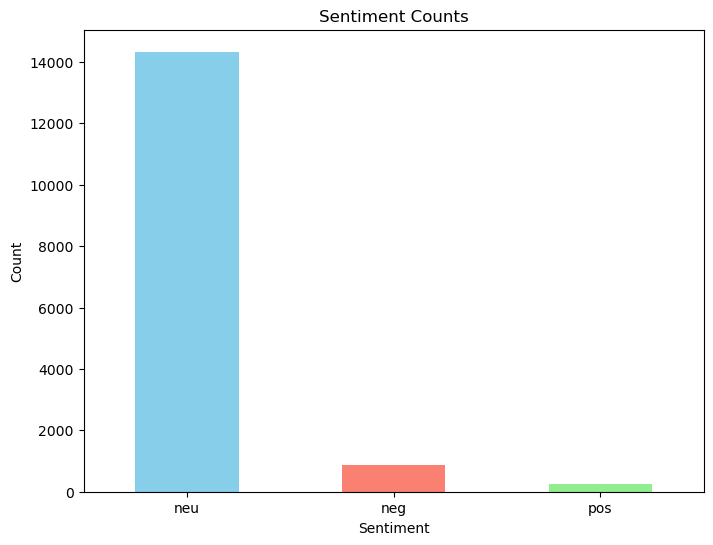

In [ ]:
# Let's create a visualization for the sentiment counts provided in the image.

# Reconstructing the data from the image into a dictionary
sentiment_counts = {
    'neu': 14331,
    'neg': 863,
    'pos': 249
}

# Convert the dictionary to a pandas Series
sentiment_series = pd.Series(sentiment_counts)

# Plotting
plt.figure(figsize=(8, 6))
sentiment_series.plot(kind='bar', color=['skyblue', 'salmon', 'lightgreen'])
plt.title('Sentiment Counts')
plt.xlabel('Sentiment')
plt.ylabel('Count')
plt.xticks(rotation=0)  # Keep the x-ticks labels horizontal
plt.show()

3.2 Grouped bar chart showing mean interaction metrics—reactions, comments, shares, comments by fans, and likes—by sentiment category, with each metric represented by a different color

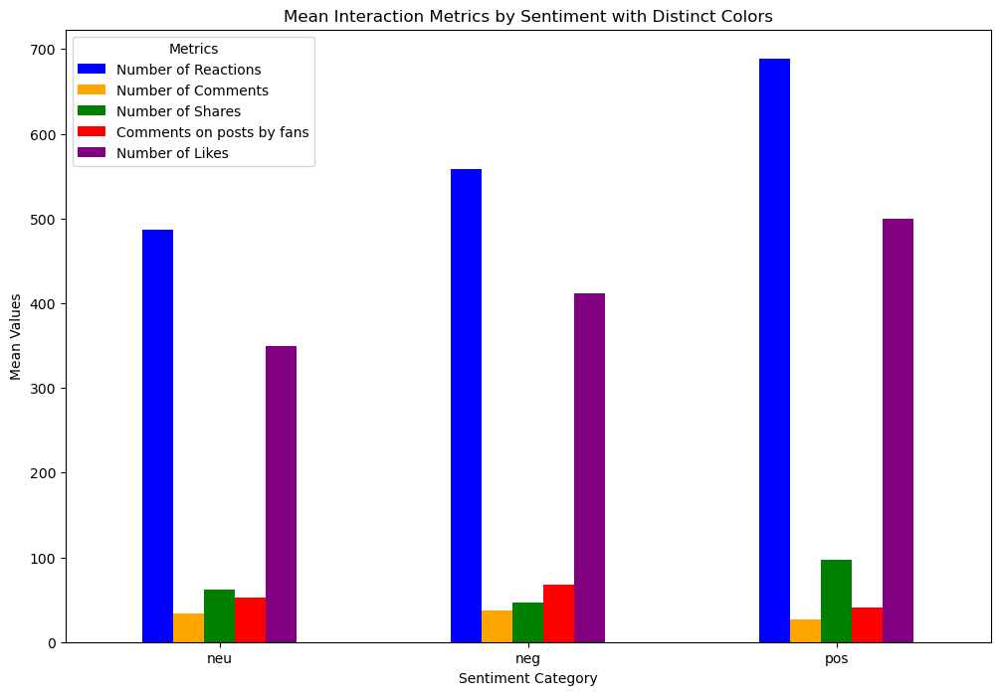

In [ ]:
# Three different DataFrames for 'neu', 'neg', and 'pos'

# Mock data creation based on the structure mentioned
df_neu = pd.DataFrame({
    'Number of Reactions': [487.07],
    'Number of Comments': [34.17],
    'Number of Shares': [62.40],
    'Comments on posts by fans': [52.26],
    'Number of Likes': [349.88]
}, index=['neu'])

df_neg = pd.DataFrame({
    'Number of Reactions': [557.96],
    'Number of Comments': [36.79],
    'Number of Shares': [46.44],
    'Comments on posts by fans': [67.84],
    'Number of Likes': [411.89]
}, index=['neg'])

df_pos = pd.DataFrame({
    'Number of Reactions': [688.65],
    'Number of Comments': [26.67],
    'Number of Shares': [97.57],
    'Comments on posts by fans': [41.06],
    'Number of Likes': [499.85]
}, index=['pos'])

# Concatenate the separate dataframes
df_all_features = pd.concat([df_neu, df_neg, df_pos])

# Colors for each metric
colors = ['blue', 'orange', 'green', 'red', 'purple']

# Plotting the grouped bar chart with different colors
ax = df_all_features.plot(kind='bar', color=colors, figsize=(12, 8))

# Adding labels and title
plt.title('Mean Interaction Metrics by Sentiment with Distinct Colors')
plt.xlabel('Sentiment Category')
plt.ylabel('Mean Values')
plt.xticks(rotation=0)

# Display the plot
plt.legend(title='Metrics')
plt.show()

3.3 This count indicates the number of times each theme park is mentioned or has activity recorded in your dataset, suggesting their presence or popularity in the dataset.

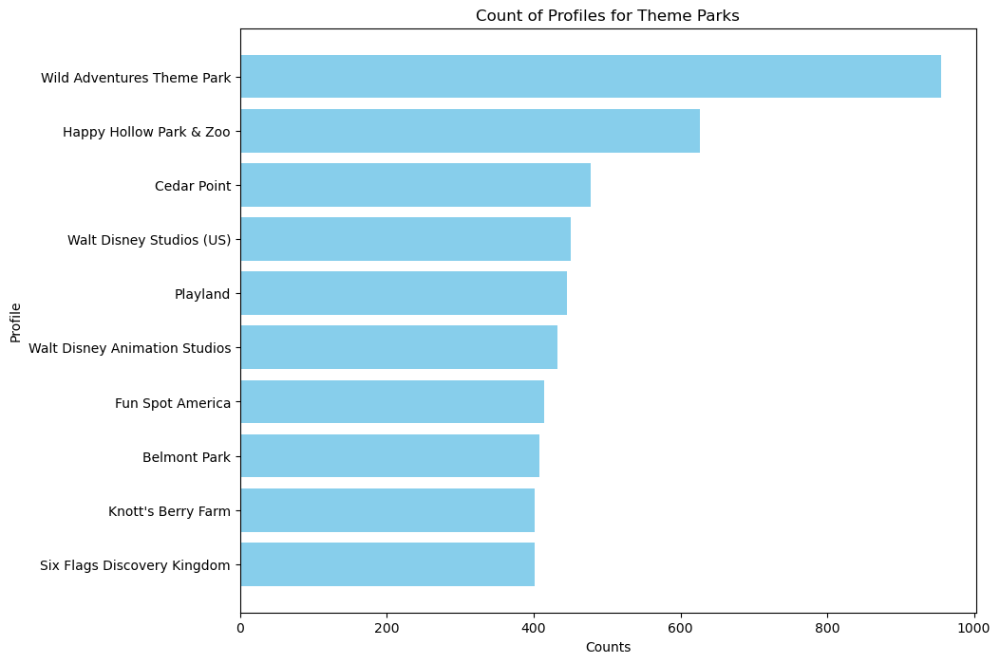

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Since we don't have the actual data, I'll recreate the DataFrame using the counts provided in the image.
# In a real scenario, you would use the DataFrame directly as follows:
# profile_df_themepark = df_themepark['Profile'].value_counts()

# Sample data based on the provided image
data = {
    'Profile': [
        "Wild Adventures Theme Park",
        "Happy Hollow Park & Zoo",
        "Cedar Point",
        "Walt Disney Studios (US)",
        "Playland",
        "Walt Disney Animation Studios",
        "Fun Spot America",
        "Belmont Park",
        "Knott's Berry Farm",
        "Six Flags Discovery Kingdom",
        # Add the rest as needed...
    ],
    'Counts': [955, 627, 478, 450, 446, 432, 414, 408, 402, 401]  # ...and their respective counts
}

# Create DataFrame
profile_df = pd.DataFrame(data)

# Plotting
plt.figure(figsize=(10,8))
plt.barh(profile_df['Profile'], profile_df['Counts'], color='skyblue')
plt.xlabel('Counts')
plt.ylabel('Profile')
plt.title('Count of Profiles for Theme Parks')
plt.gca().invert_yaxis()  # To display the highest count at the top
plt.show()